In [1]:
################################################################################
####################    Regression: Linear Regression    #######################
################################################################################
### Load necessary modules -------------------------------
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import math
plt.style.use('ggplot')
import RegressionTools as RT
import numpy as np
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.metrics import mean_squared_error
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer
from sklearn import set_config
set_config(display='diagram')

In [2]:
### Load file --------------------------------------------
dfINI = pd.read_csv('TemperaturesSpainSmall.csv', sep = ";")
dfTOT = dfINI.iloc[1:1000].dropna(axis=0, how='any')
dfTOT.head()

,DAY,MONTH,YEAR,WEEKDAY,TMIN229,TMIN230,TMIN231,TMIN232,TMIN234,TMIN236,...,TMAX3948,TMAX3949,TMAX3950,TMAX3951,TMAX3952,TMAX3954,TMAX3959,TMAX3967,TMAX3971,TMAX11034
1,2,1,1990,3,3.6,5.6,7.0,-3.4,6.0,6.9,...,7.6,18.4,11.4,11.4,11.4,12.0,20.8,8.9,12.0,14.2
2,3,1,1990,4,6.0,4.9,8.8,-4.2,8.6,4.6,...,10.4,12.8,9.0,12.2,12.2,10.0,19.2,10.6,9.0,11.6
3,4,1,1990,5,3.8,2.5,8.6,-6.6,8.2,7.8,...,11.8,13.5,8.2,9.4,9.4,9.4,19.6,12.0,7.0,14.6
4,5,1,1990,6,7.0,3.4,7.4,-3.2,8.0,3.8,...,11.0,15.3,5.8,14.8,14.8,13.0,19.6,10.7,10.6,14.4
5,6,1,1990,7,7.0,2.6,8.8,-1.4,8.0,4.2,...,6.6,16.2,5.0,12.4,12.4,11.4,21.5,8.0,11.6,13.8


In [3]:
dfTOT.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 999 entries, 1 to 999
Data columns (total 96 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   DAY        999 non-null    int64  
 1   MONTH      999 non-null    int64  
 2   YEAR       999 non-null    int64  
 3   WEEKDAY    999 non-null    int64  
 4   TMIN229    999 non-null    float64
 5   TMIN230    999 non-null    float64
 6   TMIN231    999 non-null    float64
 7   TMIN232    999 non-null    float64
 8   TMIN234    999 non-null    float64
 9   TMIN236    999 non-null    float64
 10  TMIN237    999 non-null    float64
 11  TMIN238    999 non-null    float64
 12  TMIN414    999 non-null    float64
 13  TMIN416    999 non-null    float64
 14  TMIN417    999 non-null    float64
 15  TMIN421    999 non-null    float64
 16  TMIN422    999 non-null    float64
 17  TMIN1389   999 non-null    float64
 18  TMIN1392   999 non-null    float64
 19  TMIN1396   999 non-null    float64
 20  TMIN1397  

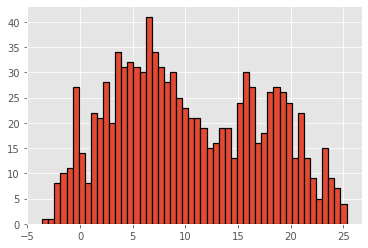

In [4]:
# Output variable (TMIN MADRID-RETIRO)
plt.hist(x=dfTOT.TMIN230, bins=50, edgecolor='black', linewidth=1.2)
plt.show()

In [5]:
# Subsets variables
df = dfTOT[["WEEKDAY","MONTH","TMIN230","TMAX230","TMAX229","TMAX237","TMAX417","TMAX2969","TMAX3910","TMAX3918","TMAX3959"]]
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 999 entries, 1 to 999
Data columns (total 11 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   WEEKDAY   999 non-null    int64  
 1   MONTH     999 non-null    int64  
 2   TMIN230   999 non-null    float64
 3   TMAX230   999 non-null    float64
 4   TMAX229   999 non-null    float64
 5   TMAX237   999 non-null    float64
 6   TMAX417   999 non-null    float64
 7   TMAX2969  999 non-null    float64
 8   TMAX3910  999 non-null    float64
 9   TMAX3918  999 non-null    float64
 10  TMAX3959  999 non-null    float64
dtypes: float64(9), int64(2)
memory usage: 93.7 KB


In [6]:
### Convert necessary variable to factor
df.WEEKDAY = df.WEEKDAY.astype('category')
df.MONTH = df.MONTH.astype('category')
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 999 entries, 1 to 999
Data columns (total 11 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   WEEKDAY   999 non-null    category
 1   MONTH     999 non-null    category
 2   TMIN230   999 non-null    float64 
 3   TMAX230   999 non-null    float64 
 4   TMAX229   999 non-null    float64 
 5   TMAX237   999 non-null    float64 
 6   TMAX417   999 non-null    float64 
 7   TMAX2969  999 non-null    float64 
 8   TMAX3910  999 non-null    float64 
 9   TMAX3918  999 non-null    float64 
 10  TMAX3959  999 non-null    float64 
dtypes: category(2), float64(9)
memory usage: 80.8 KB


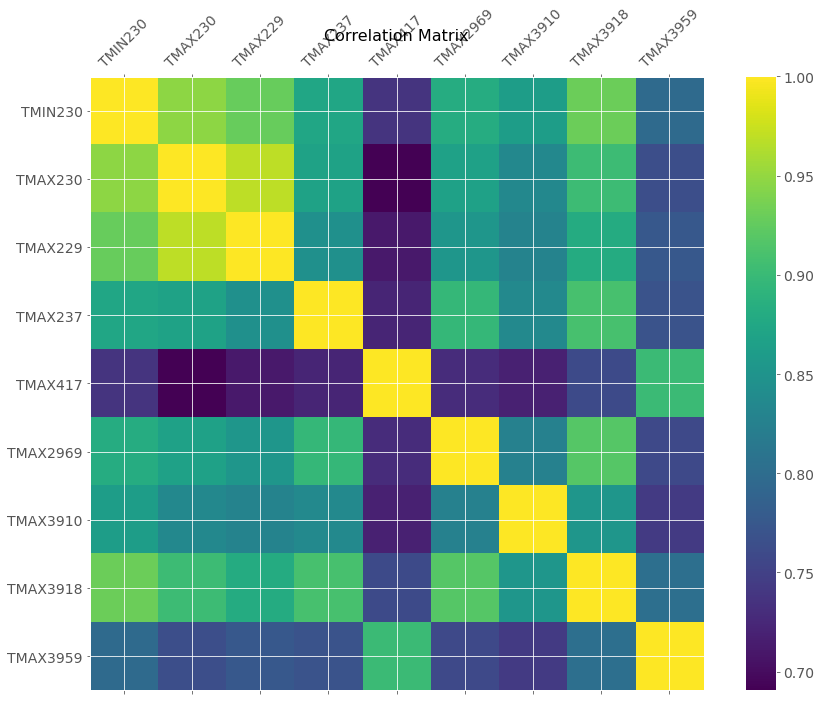

In [7]:
#correlation plot of numeric variables
f = plt.figure(figsize=(15, 11))
plt.matshow(df.select_dtypes(include=['int64','float64']).corr(), fignum=f.number)
plt.xticks(range(df.select_dtypes(include=['int64','float64']).shape[1]), df.select_dtypes(include=['int64','float64']).columns, fontsize=14, rotation=45)
plt.yticks(range(df.select_dtypes(include=['int64','float64']).shape[1]), df.select_dtypes(include=['int64','float64']).columns, fontsize=14)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.title('Correlation Matrix', fontsize=16)
plt.show()

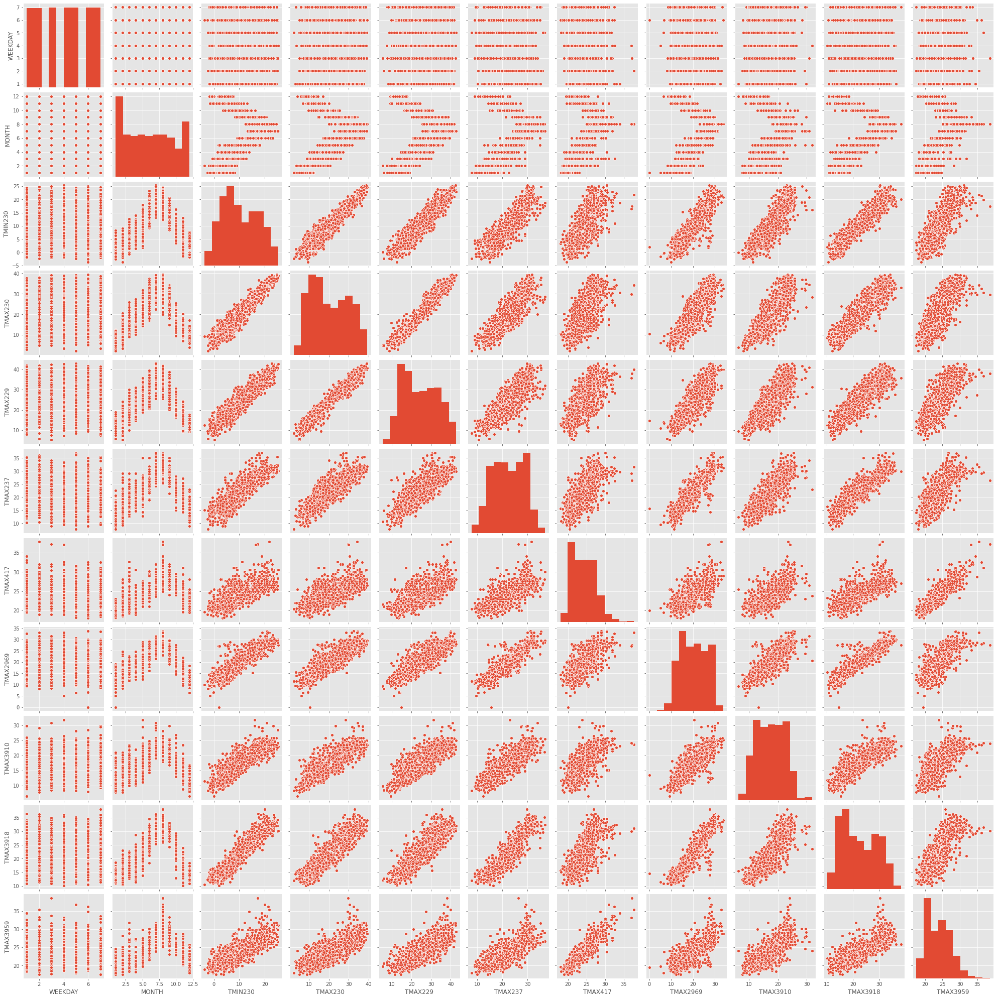

In [8]:
### Exploratory analysis -------------------------------------------------------------------------------------
sns.pairplot(df, vars=df.columns.values.tolist())
plt.show()

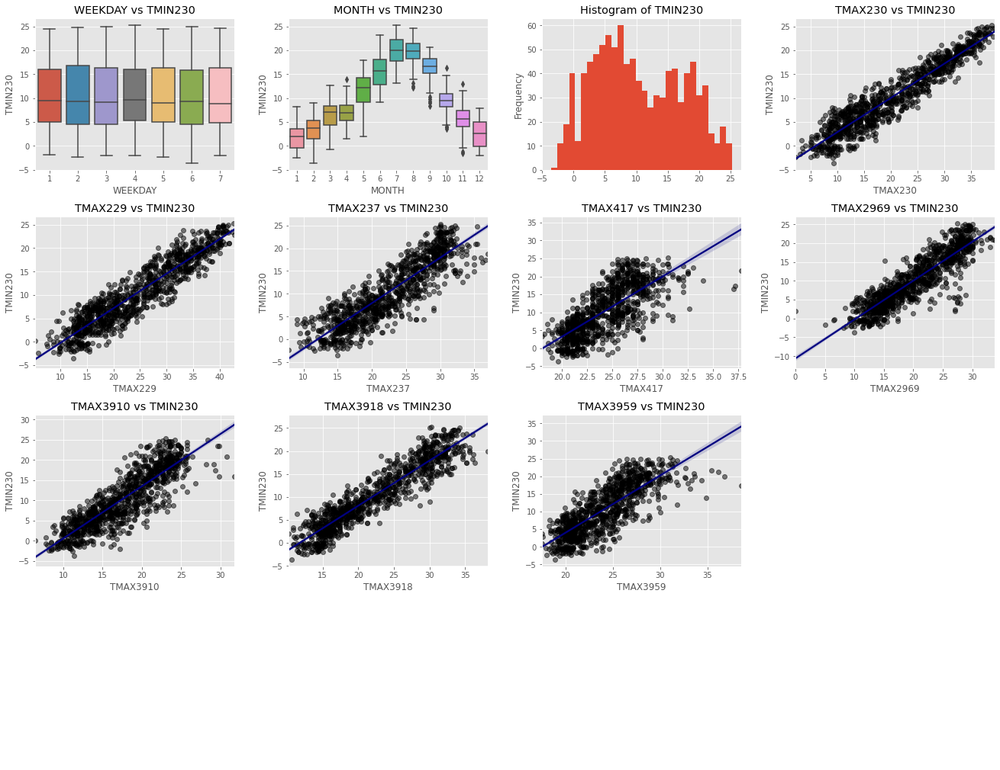

In [9]:
#To analyze in greater detail the relation between inputs and output, use PlotDataframe function
RT.PlotDataframe(df, 'TMIN230')

In [10]:
X = df.loc[:, df.columns != 'TMIN230']
y = df['TMIN230']
## Divide the data into training and test sets ---------------------------------------------------
## Create random 80/20 % split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 5)

## Create dataset to store model predictions
dfTR_eval = X_train.copy()
dfTR_eval['TMIN230'] = y_train
dfTS_eval = X_test.copy()
dfTS_eval['TMIN230'] = y_test

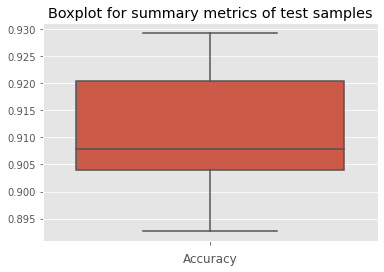

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('num',
                                                                         Pipeline(steps=[('imputer',
                                                                                          SimpleImputer(strategy='median')),
                                                                                         ('scaler',
                                                                                          StandardScaler())]),
                                                                         ['TMAX230']),
                                                                        ('cat',
                                                                         Pipeline(steps=[('imputer',
                                                                                          SimpleImputer(fill_value='missing',
                                                                                                        strategy='constant')),
                                                                                         ('onehot',
                                                                                          OneHotEncoder(handle_unknown='ignore'))]),
                                                                         ['WEEKDAY',
                                                                          'MONTH'])])),
                                       ('LR_model', LinearRegression())]),
             n_jobs=-1, param_grid={})

In [11]:
#-------------------------------------------------------------------------------------------------
#------------------------------- Linear Regression MODEL -----------------------------------------
#-------------------------------------------------------------------------------------------------
# Prepare the numeric variables by imputing by its median and scaling
# numeric_features = X_train.select_dtypes(include=['int64','float64']).columns.values.tolist()
numeric_features = ['TMAX230']
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())])

# Prepare the categorical variables by imputing by last value and encoding the categories
categorical_features = X_train.select_dtypes(include=['category']).columns.values.tolist()
categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='missing')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))])

# Create a preprocessor to perform the steps defined above
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
        ])

param = {} 
pipe = Pipeline([
            ('preprocessor', preprocessor),
            ('LR_model', LinearRegression())
        ])
# We use Grid Search Cross Validation to find the best parameter for the model in the grid defined 
nFolds = 10
LR_fit = GridSearchCV(estimator=pipe, # Structure of the model to use
                       param_grid=param, # Defined grid to search in
                       n_jobs=-1, # Number of cores to use (parallelize)
                       cv=nFolds) # Number of Folds 
LR_fit.fit(X_train[numeric_features + categorical_features], y_train) # Search in grid

# Plot the cross validation score (accuracy) in the Grid Search
nFolds = 10
cv_errors = np.empty([nFolds,len(LR_fit.cv_results_['split0_test_score'])])
for split in range(nFolds):
    cv_errors[split,:] = LR_fit.cv_results_['split' + str(split) + '_test_score']
meanAcc = cv_errors.mean(0)
stdAcc = cv_errors.std(0)

scores_LR1 = meanAcc # Store cv-scores for later

ax = sns.boxplot(y=cv_errors).set_title('Boxplot for summary metrics of test samples')
plt.xlabel('Accuracy')
plt.show()
LR_fit

In [12]:
RT.summaryLinReg(LR_fit.best_estimator_, X_train[numeric_features + categorical_features], y_train)  #information about the model trained

Residuals:
        Min        1Q    Median       3Q       Max
0 -5.575769 -1.329215 -0.023457  1.35507  5.138281

Coefficients:
                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.917
Model:                            OLS   Adj. R-squared:                  0.915
Method:                 Least Squares   F-statistic:                     477.3
Date:                Thu, 13 Aug 2020   Prob (F-statistic):               0.00
Time:                        20:15:46   Log-Likelihood:                -1674.1
No. Observations:                 799   AIC:                             3386.
Df Residuals:                     780   BIC:                             3475.
Df Model:                          18                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
---

In [13]:
dfTR_eval['LR_pred'] = LR_fit.predict(X_train)
dfTS_eval['LR_pred'] = LR_fit.predict(X_test)

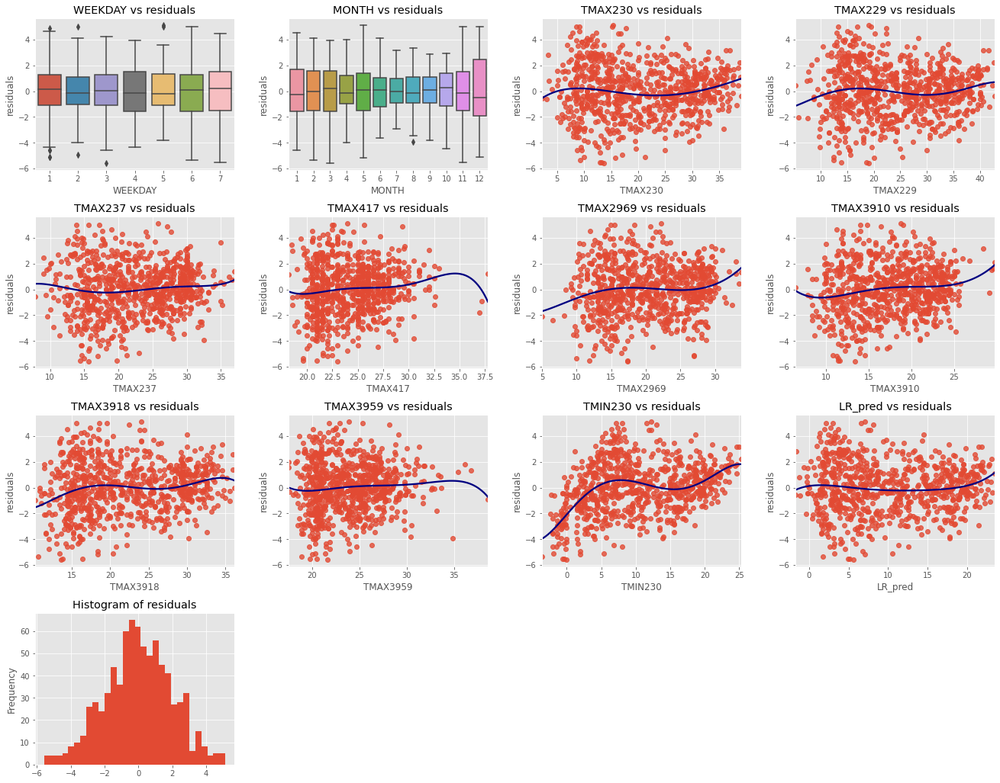

In [14]:
#Analysis of residuals
RT.plotModelDiagnosis(dfTR_eval, 'LR_pred', 'TMIN230')

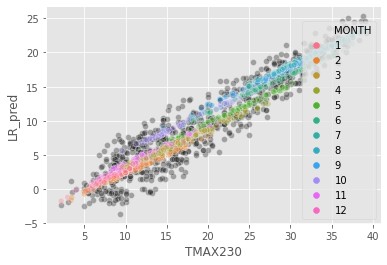

In [15]:
#Plot TMIN230 vs TMAX230
plt.figure()
sns.scatterplot(x='TMAX230', y='TMIN230', data=dfTR_eval, alpha=0.3, color='black')
sns.scatterplot(x='TMAX230', y='LR_pred', hue='MONTH', data=dfTR_eval, alpha=0.3)
plt.show()

In [16]:
#Training and test errors
print('Training RMSE:',mean_squared_error(dfTR_eval.TMIN230, dfTR_eval.LR_pred))
print('Test RMSE:',mean_squared_error(dfTS_eval.TMIN230, dfTS_eval.LR_pred))

Training RMSE: 3.867055324818923
Test RMSE: 4.045880469092119


In [17]:
# Group factors
X_train['MONTHg'] = X_train['MONTH'].astype('int64').replace([1,2,3,4,12], 1).astype('category')
X_test['MONTHg'] = X_test['MONTH'].astype('int64').replace([1,2,3,4,12], 1).astype('category')

dfTR_eval['MONTHg'] = X_train['MONTHg']
dfTS_eval['MONTHg'] = X_test['MONTHg']

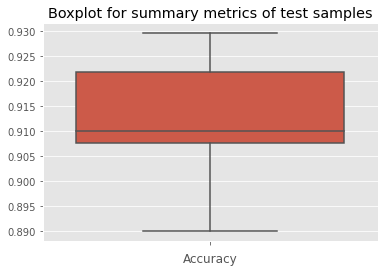

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('num',
                                                                         Pipeline(steps=[('imputer',
                                                                                          SimpleImputer(strategy='median')),
                                                                                         ('scaler',
                                                                                          StandardScaler())]),
                                                                         ['TMAX230']),
                                                                        ('cat',
                                                                         Pipeline(steps=[('imputer',
                                                                                          SimpleImputer(strategy='constant')),
                                                                                         ('onehot',
                                                                                          OneHotEncoder(handle_unknown='ignore'))]),
                                                                         ['MONTHg'])])),
                                       ('LR_model', LinearRegression())]),
             n_jobs=-1, param_grid={})

In [18]:
#-------------------------------------------------------------------------------------------------
#------------------------------- Linear Regression MODEL -----------------------------------------
#-------------------------------------------------------------------------------------------------
# Prepare the numeric variables by imputing by its median and scaling
# numeric_features = X_train.select_dtypes(include=['int64','float64']).columns.values.tolist()
numeric_features = ['TMAX230']
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())])

# Prepare the categorical variables by imputing by last value and encoding the categories
categorical_features = ['MONTHg']
categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))])

# Create a preprocessor to perform the steps defined above
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
        ])

param = {} 
pipe = Pipeline([
            ('preprocessor', preprocessor),
            ('LR_model', LinearRegression())
        ])
# We use Grid Search Cross Validation to find the best parameter for the model in the grid defined 
nFolds = 10
LR2_fit = GridSearchCV(estimator=pipe, # Structure of the model to use
                       param_grid=param, # Defined grid to search in
                       n_jobs=-1, # Number of cores to use (parallelize)
                       cv=nFolds) # Number of Folds 
LR2_fit.fit(X_train[numeric_features + categorical_features], y_train) # Search in grid

# Plot the cross validation score (accuracy) in the Grid Search
nFolds = 10
cv_errors = np.empty([nFolds,len(LR2_fit.cv_results_['split0_test_score'])])
for split in range(nFolds):
    cv_errors[split,:] = LR2_fit.cv_results_['split' + str(split) + '_test_score']
meanAcc = cv_errors.mean(0)
stdAcc = cv_errors.std(0)

scores_LR2 = meanAcc # Store cv-scores for later

ax = sns.boxplot(y=cv_errors).set_title('Boxplot for summary metrics of test samples')
plt.xlabel('Accuracy')
plt.show()
LR2_fit

In [19]:
RT.summaryLinReg(LR2_fit.best_estimator_, X_train[numeric_features + categorical_features], y_train)  #information about the model trained

Residuals:
        Min        1Q    Median        3Q       Max
0 -5.988199 -1.300011 -0.014731  1.295727  5.278995

Coefficients:
                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.915
Model:                            OLS   Adj. R-squared:                  0.914
Method:                 Least Squares   F-statistic:                     1063.
Date:                Thu, 13 Aug 2020   Prob (F-statistic):               0.00
Time:                        20:15:57   Log-Likelihood:                -1682.6
No. Observations:                 799   AIC:                             3383.
Df Residuals:                     790   BIC:                             3425.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
-

In [20]:
dfTR_eval['LR2_pred'] = LR2_fit.predict(X_train)
dfTS_eval['LR2_pred'] = LR2_fit.predict(X_test)

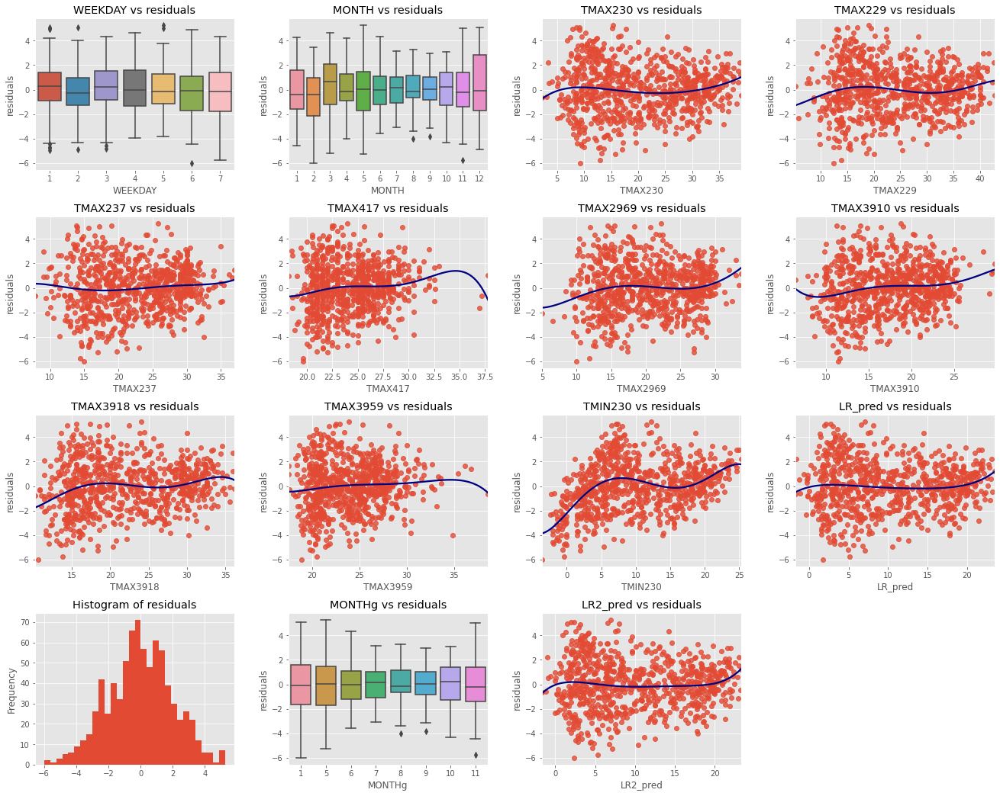

In [21]:
#Analysis of residuals
RT.plotModelDiagnosis(dfTR_eval, 'LR2_pred', 'TMIN230')

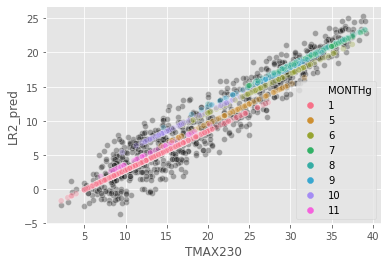

In [22]:
#Plot TMIN230 vs TMAX230
plt.figure()
sns.scatterplot(x='TMAX230', y='TMIN230', data=dfTR_eval, alpha=0.3, color='black')
sns.scatterplot(x='TMAX230', y='LR2_pred', hue='MONTHg', data=dfTR_eval, alpha=0.3)
plt.show()

In [23]:
#Training and test errors
print('Training RMSE:',mean_squared_error(dfTR_eval.TMIN230, dfTR_eval.LR2_pred))
print('Test RMSE:',mean_squared_error(dfTS_eval.TMIN230, dfTS_eval.LR2_pred))

Training RMSE: 3.950852074789724
Test RMSE: 3.9385184256001047


In [24]:
# Next model introducing interaction
X_train = pd.concat([X_train.reset_index(), pd.DataFrame(X_train['TMAX230'].to_numpy().reshape(X_train.shape[0],1) * pd.get_dummies(X_train['MONTHg']).to_numpy(), columns=['TMAX230_1','TMAX230_5','TMAX230_6','TMAX230_7','TMAX230_8','TMAX230_9','TMAX230_10','TMAX230_11'])], axis=1)
X_test = pd.concat([X_test.reset_index(), pd.DataFrame(X_test['TMAX230'].to_numpy().reshape(X_test.shape[0],1) * pd.get_dummies(X_test['MONTHg']).to_numpy(), columns=['TMAX230_1','TMAX230_5','TMAX230_6','TMAX230_7','TMAX230_8','TMAX230_9','TMAX230_10','TMAX230_11'])], axis=1)

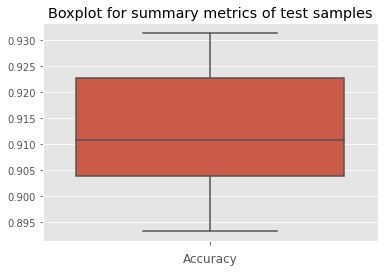

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('num',
                                                                         Pipeline(steps=[('imputer',
                                                                                          SimpleImputer(strategy='median')),
                                                                                         ('scaler',
                                                                                          StandardScaler())]),
                                                                         ['TMAX230_1',
                                                                          'TMAX230_5',
                                                                          'TMAX230_6',
                                                                          'TMAX230_7',
                                                                          'TMAX230_8',
                                                                          'TMAX230_9',
                                                                          'TMAX230_10',
                                                                          'TMAX230_11'])])),
                                       ('LR_model', LinearRegression())]),
             n_jobs=-1, param_grid={})

In [25]:
#-------------------------------------------------------------------------------------------------
#------------------------------- Linear Regression MODEL -----------------------------------------
#-------------------------------------------------------------------------------------------------
# Prepare the numeric variables by imputing by its median and scaling
# numeric_features = X_train.select_dtypes(include=['int64','float64']).columns.values.tolist()
numeric_features = ['TMAX230_1','TMAX230_5','TMAX230_6','TMAX230_7','TMAX230_8','TMAX230_9','TMAX230_10','TMAX230_11']
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())])


# Create a preprocessor to perform the steps defined above
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features)
        ])

param = {} 
pipe = Pipeline([
            ('preprocessor', preprocessor),
            ('LR_model', LinearRegression())
        ])
# We use Grid Search Cross Validation to find the best parameter for the model in the grid defined 
nFolds = 10
LR3_fit = GridSearchCV(estimator=pipe, # Structure of the model to use
                       param_grid=param, # Defined grid to search in
                       n_jobs=-1, # Number of cores to use (parallelize)
                       cv=nFolds) # Number of Folds 
LR3_fit.fit(X_train[numeric_features], y_train) # Search in grid

# Plot the cross validation score (accuracy) in the Grid Search
nFolds = 10
cv_errors = np.empty([nFolds,len(LR3_fit.cv_results_['split0_test_score'])])
for split in range(nFolds):
    cv_errors[split,:] = LR3_fit.cv_results_['split' + str(split) + '_test_score']
meanAcc = cv_errors.mean(0)
stdAcc = cv_errors.std(0)

scores_LR3 = meanAcc # Store cv-scores for later

ax = sns.boxplot(y=cv_errors).set_title('Boxplot for summary metrics of test samples')
plt.xlabel('Accuracy')
plt.show()
LR3_fit

In [26]:
RT.summaryLinReg(LR3_fit.best_estimator_, X_train[numeric_features], y_train)  #information about the model trained

Residuals:
        Min        1Q    Median       3Q       Max
0 -6.216186 -1.300991  0.048886  1.35236  5.383596

Coefficients:
                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.915
Model:                            OLS   Adj. R-squared:                  0.914
Method:                 Least Squares   F-statistic:                     1063.
Date:                Thu, 13 Aug 2020   Prob (F-statistic):               0.00
Time:                        20:16:07   Log-Likelihood:                -1682.5
No. Observations:                 799   AIC:                             3383.
Df Residuals:                     790   BIC:                             3425.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
---

In [27]:
dfTR_eval['LR3_pred'] = LR3_fit.predict(X_train)
dfTS_eval['LR3_pred'] = LR3_fit.predict(X_test)

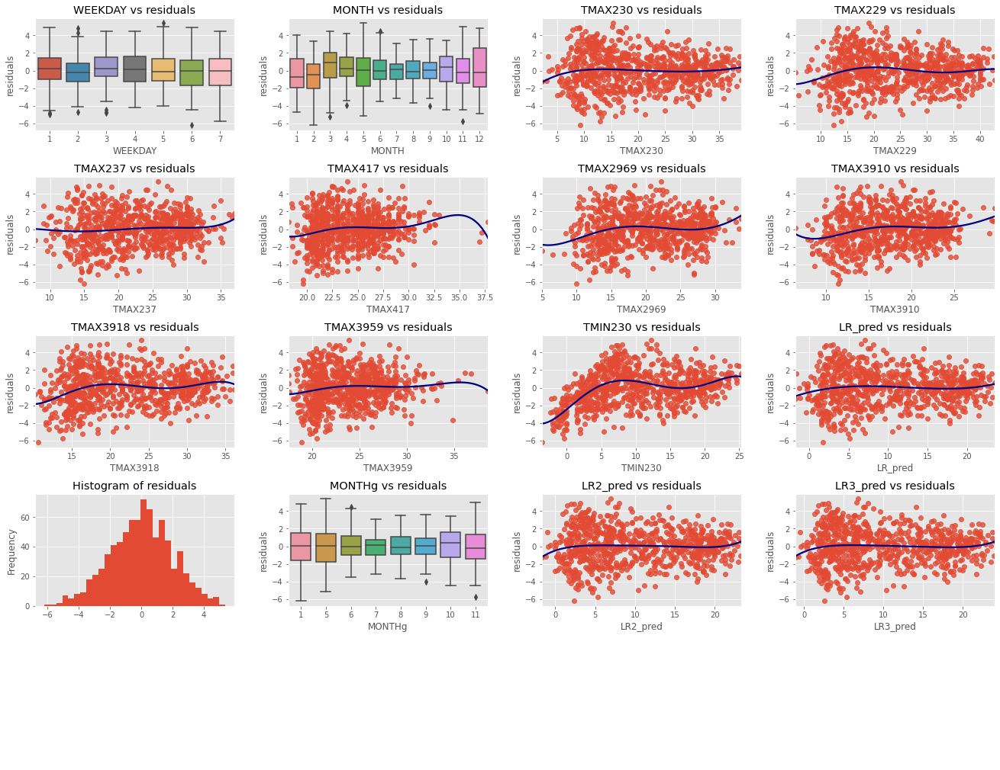

In [28]:
#Analysis of residuals
RT.plotModelDiagnosis(dfTR_eval, 'LR3_pred', 'TMIN230')

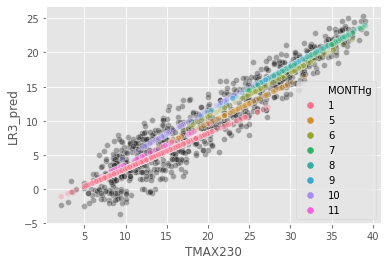

In [29]:
#Plot TMIN230 vs TMAX230
plt.figure()
sns.scatterplot(x='TMAX230', y='TMIN230', data=dfTR_eval, alpha=0.3, color='black')
sns.scatterplot(x='TMAX230', y='LR3_pred', hue='MONTHg', data=dfTR_eval, alpha=0.3)
plt.show()

In [30]:
#Introduce a second order variable
X_train['TMAX230_2'] = X_train['TMAX230'] ** 2
X_test['TMAX230_2'] = X_test['TMAX230'] ** 2
dfTR_eval['TMAX230_2'] = X_train['TMAX230_2']
dfTS_eval['TMAX230_2'] = X_test['TMAX230_2']

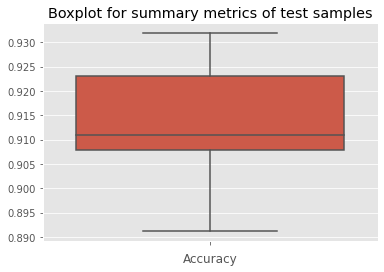

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('num',
                                                                         Pipeline(steps=[('imputer',
                                                                                          SimpleImputer(strategy='median')),
                                                                                         ('scaler',
                                                                                          StandardScaler())]),
                                                                         ['TMAX230',
                                                                          'TMAX230_2']),
                                                                        ('cat',
                                                                         Pipeline(steps=[('imputer',
                                                                                          SimpleImputer(strategy='constant')),
                                                                                         ('onehot',
                                                                                          OneHotEncoder(handle_unknown='ignore'))]),
                                                                         ['MONTHg'])])),
                                       ('LR_model', LinearRegression())]),
             n_jobs=-1, param_grid={})

In [31]:
#-------------------------------------------------------------------------------------------------
#------------------------------- Linear Regression MODEL -----------------------------------------
#-------------------------------------------------------------------------------------------------
# Prepare the numeric variables by imputing by its median and scaling
# numeric_features = X_train.select_dtypes(include=['int64','float64']).columns.values.tolist()
numeric_features = ['TMAX230','TMAX230_2']
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())])

# Prepare the categorical variables by imputing by last value and encoding the categories
categorical_features = ['MONTHg']
categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))])

# Create a preprocessor to perform the steps defined above
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
        ])

param = {} 
pipe = Pipeline([
            ('preprocessor', preprocessor),
            ('LR_model', LinearRegression())
        ])
# We use Grid Search Cross Validation to find the best parameter for the model in the grid defined 
nFolds = 10
LR4_fit = GridSearchCV(estimator=pipe, # Structure of the model to use
                       param_grid=param, # Defined grid to search in
                       n_jobs=-1, # Number of cores to use (parallelize)
                       cv=nFolds) # Number of Folds 
LR4_fit.fit(X_train[numeric_features + categorical_features], y_train) # Search in grid

# Plot the cross validation score (accuracy) in the Grid Search
nFolds = 10
cv_errors = np.empty([nFolds,len(LR4_fit.cv_results_['split0_test_score'])])
for split in range(nFolds):
    cv_errors[split,:] = LR4_fit.cv_results_['split' + str(split) + '_test_score']
meanAcc = cv_errors.mean(0)
stdAcc = cv_errors.std(0)

scores_LR4 = meanAcc # Store cv-scores for later

ax = sns.boxplot(y=cv_errors).set_title('Boxplot for summary metrics of test samples')
plt.xlabel('Accuracy')
plt.show()
LR4_fit

In [32]:
RT.summaryLinReg(LR4_fit.best_estimator_, X_train[numeric_features + categorical_features], y_train)  #information about the model trained

Residuals:
        Min        1Q    Median       3Q       Max
0 -6.109639 -1.262589  0.028779  1.32332  5.326021

Coefficients:
                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.916
Model:                            OLS   Adj. R-squared:                  0.915
Method:                 Least Squares   F-statistic:                     954.0
Date:                Thu, 13 Aug 2020   Prob (F-statistic):               0.00
Time:                        20:16:17   Log-Likelihood:                -1678.5
No. Observations:                 799   AIC:                             3377.
Df Residuals:                     789   BIC:                             3424.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
---

In [33]:
dfTR_eval['LR4_pred'] = LR3_fit.predict(X_train)
dfTS_eval['LR4_pred'] = LR3_fit.predict(X_test)

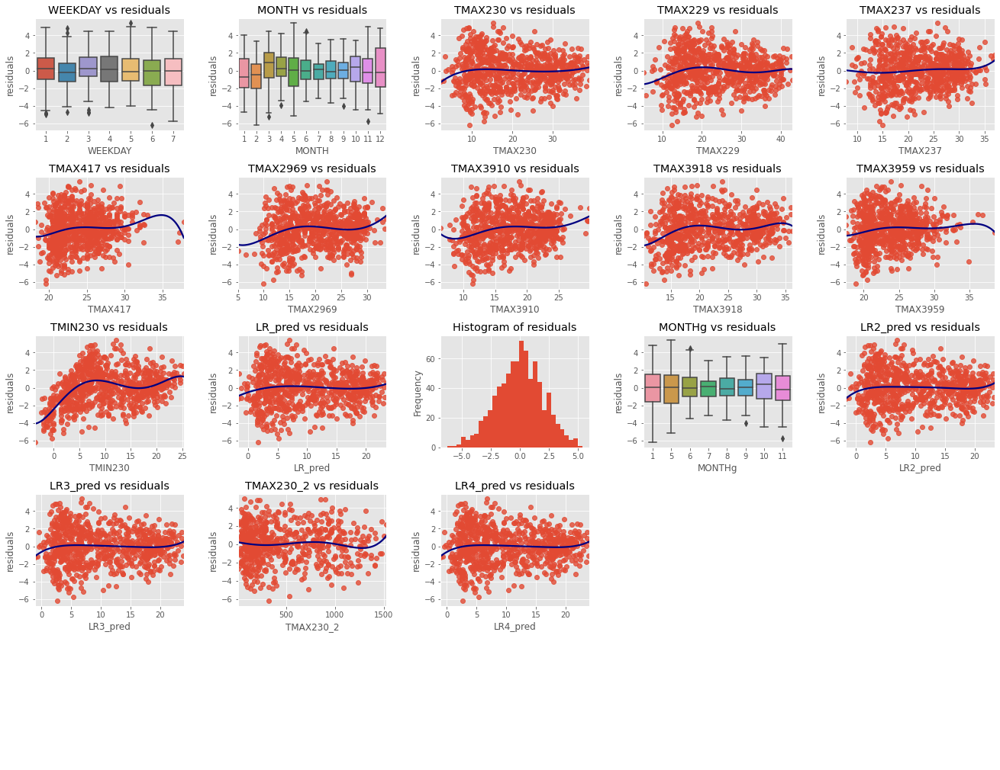

In [34]:
#Analysis of residuals
RT.plotModelDiagnosis(dfTR_eval, 'LR4_pred', 'TMIN230')

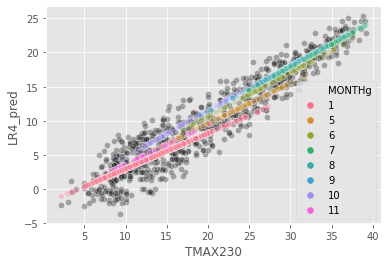

In [35]:
#Plot TMIN230 vs TMAX230
plt.figure()
sns.scatterplot(x='TMAX230', y='TMIN230', data=dfTR_eval, alpha=0.3, color='black')
sns.scatterplot(x='TMAX230', y='LR4_pred', hue='MONTHg', data=dfTR_eval, alpha=0.3)
plt.show()

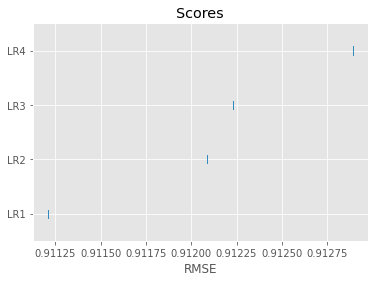

In [37]:
## Compare models
metric = 'RMSE'
score = {'LR1': scores_LR1, 'LR2': scores_LR2, 'LR3': scores_LR3, 'LR4': scores_LR4}
RT.dotplot(score, metric)